In [1]:
import os
import pandas as pd
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap
import re
import random
pd.options.mode.chained_assignment = None

## In this visualization, black triangle reprents assets which is impacts and red circle reprents the hurricane. The radius of the red circle represents the hurricane level according to USA_SSHS.

In [2]:
repo = os.path.dirname(os.path.abspath(''))
storm = pd.read_csv(os.path.join(repo, "data", "interim", "Storms.csv"))

In [3]:
storm

,Unnamed: 0,Name,Category,StormSpeed,WindSpeed,LF_DateTime,LF_Lat,LF_Lon,LF_StormSpeed,LF_WindSpeed,...,LF_RadiusCat2,LF_RadiusCat3,LF_RadiusCat4,LF_RadiusCat5,LF_DurationCat0,LF_DurationCat1,LF_DurationCat2,LF_DurationCat3,LF_DurationCat4,LF_DurationCat5
0,0,DEAN2007,5.0,22.0,150.0,2007-08-21 08:30:00,18.7000,-87.7000,18.0,150.0,...,33.0,15.0,12.0,12.0,24.0,21.0,15.0,9.0,6.0,6.0
1,1,FELIX2007,5.0,20.0,150.0,2007-09-04 12:00:00,14.3000,-83.2000,16.0,140.0,...,15.0,12.0,10.0,10.0,18.0,12.0,9.0,6.0,3.0,3.0
2,2,HUMBERTO2007,1.0,11.0,80.0,2007-09-13 09:00:00,29.8569,-94.0434,11.0,74.0,...,NaN,NaN,NaN,NaN,12.0,6.0,0.0,0.0,0.0,0.0
3,3,LORENZO2007,1.0,8.0,70.0,2007-09-28 05:00:00,20.5000,-97.0000,8.0,65.0,...,NaN,NaN,NaN,NaN,9.0,6.0,0.0,0.0,0.0,0.0
4,4,NOEL2007,1.0,41.0,75.0,2007-10-29 15:00:00,19.7408,-73.2102,41.0,62.0,...,NaN,NaN,NaN,NaN,30.0,0.0,0.0,0.0,0.0,0.0
5,5,DOLLY2008,2.0,21.0,85.0,2008-07-21 05:30:00,20.8000,-87.0000,21.0,70.0,...,NaN,NaN,NaN,NaN,36.0,9.0,0.0,0.0,0.0,0.0
6,6,GUSTAV2008,4.0,26.0,135.0,2008-08-26 18:00:00,18.1000,-72.8000,26.0,125.0,...,25.0,15.0,15.0,NaN,51.0,18.0,12.0,6.0,6.0,0.0
7,7,HANNA2008,1.0,36.0,75.0,2008-09-06 09:00:00,34.5805,-78.4980,36.0,54.0,...,NaN,NaN,NaN,NaN,18.0,0.0,0.0,0.0,0.0,0.0
8,8,IKE2008,4.0,54.0,125.0,2008-09-07 13:00:00,21.0000,-73.2000,54.0,110.0,...,30.0,15.0,NaN,NaN,54.0,36.0,21.0,9.0,0.0,0.0
9,9,KYLE2008,1.0,25.0,75.0,2008-09-29 00:00:00,43.8000,-66.2000,23.0,65.0,...,NaN,NaN,NaN,NaN,6.0,3.0,0.0,0.0,0.0,0.0


# plot all of the storm

In [4]:
stormname = storm['Name']
Category = storm['Category']
LF_Lon = storm['LF_Lon']
LF_Lat = storm['LF_Lat']

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


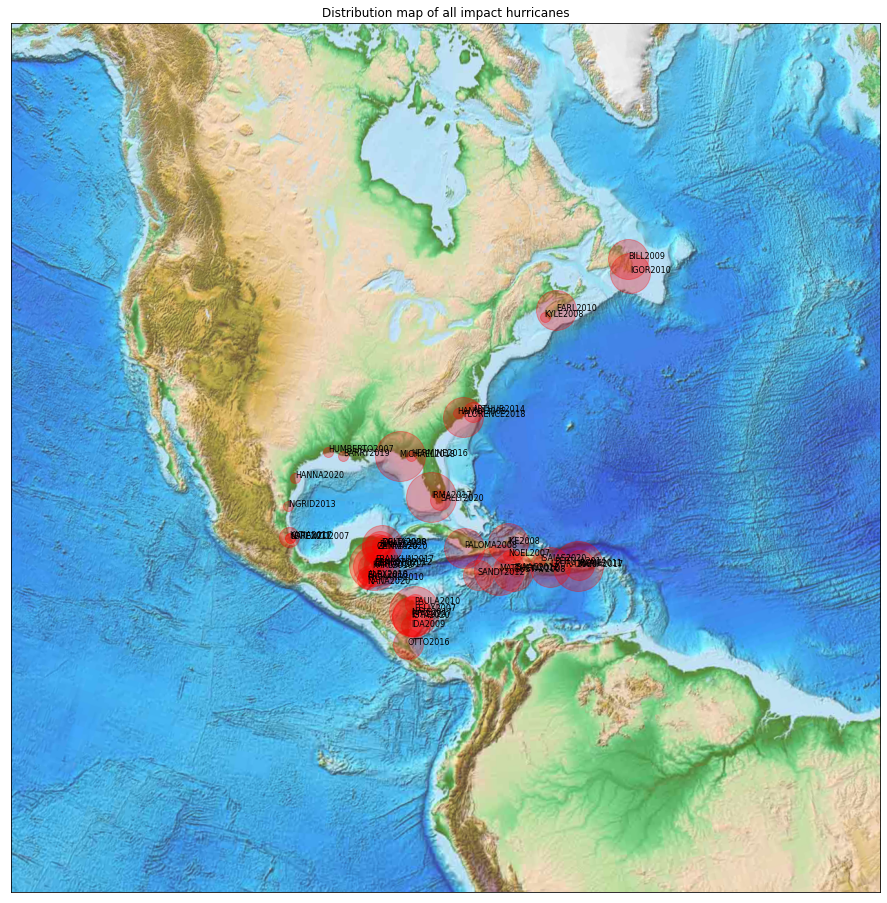

In [5]:
fig = plt.figure(figsize=(16, 16))
m = Basemap(projection='lcc', resolution=None,
            width=10E6, height=10E6, 
            lat_0=30, lon_0=-80,)
m.etopo(scale=1, alpha=0.8)
plt.title("Distribution map of all impact hurricanes")
for i in range(len(stormname)):
    x, y = m(LF_Lon[i], LF_Lat[i])
    if Category[i] == 1:
        plt.plot(x, y, 'or', markersize=10, alpha=0.3)
        plt.text(x, y, stormname[i], fontsize=8)
    elif Category[i] == 2:
        plt.plot(x, y, 'or', markersize=20, alpha=0.3)
        plt.text(x, y, stormname[i], fontsize=8)
    elif Category[i] == 3:
        plt.plot(x, y, 'or', markersize=30, alpha=0.3)
        plt.text(x, y, stormname[i], fontsize=8)
    elif Category[i] == 4:
        plt.plot(x, y, 'or', markersize=40, alpha=0.3)
        plt.text(x, y, stormname[i], fontsize=8)
    elif Category[i] == 5:
        plt.plot(x, y, 'or', markersize=50, alpha=0.3)
        plt.text(x, y, stormname[i], fontsize=8)

In [6]:
company = pd.read_csv(os.path.join(repo, "data", "interim", "StormAssets.csv"))
company

,Unnamed: 0,InstitutionName,PropertyKey,PropertyName,Ticker,CompanyNameShort,Latitude,Longitude,PrimaryPropertyType,AcquisitionDate,SoldDate,StormName,Year,HitDate,Category,HitCategory
0,0,American Financial Realty Trust,74982,Beaumont,NaN,American Financial Realty Tr.,30.084644,-94.126774,Office,2004-10-01 00:00:00,2008-04-01 00:00:00,HUMBERTO2007,2007,2007-09-13 09:00:00,1,0
1,1,American Financial Realty Trust,75136,Nederland,NaN,American Financial Realty Tr.,29.974953,-93.992012,Office,2004-10-01 00:00:00,2008-04-01 00:00:00,HUMBERTO2007,2007,2007-09-13 09:00:00,1,0
2,2,"American Realty Capital Trust III, Inc.",217247,Mattress Firm-Nederland,NaN,American Realty Capital Tr III,29.948446,-93.992877,Other Retail,2012-09-30 00:00:00,2013-02-28 00:00:00,HUMBERTO2007,2007,2007-09-13 09:00:00,1,0
3,3,"American Realty Capital Trust, Inc.",185488,Restaurants-Quick Service-Beaumont,NaN,American Realty Capital Trust,30.096670,-94.111580,Specialty,2010-06-29 00:00:00,2013-01-22 00:00:00,HUMBERTO2007,2007,2007-09-13 09:00:00,1,0
4,4,"American Realty Investors, Inc.",363531,Farnham Park,ARL,American Realty Investors Inc.,29.947540,-93.983540,Multifamily,2018-11-30 00:00:00,2020-07-16 00:00:00,HUMBERTO2007,2007,2007-09-13 09:00:00,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9850,9850,Fibra UNO,370238,Centro Maya-Morado,FUNO 11,Fibra UNO,20.618860,-87.097010,Other Retail,2012-08-31 00:00:00,NaN,ZETA2020,2020,2020-10-27 03:55:00,3,0
9851,9851,FibraHotel,266776,Hotel Cacao Playa del Carmen,FIHO 12,FibraHotel,20.632920,-87.067420,Hotel,2014-11-19 00:00:00,NaN,ZETA2020,2020,2020-10-27 03:55:00,3,0
9852,9852,Hyatt Hotels Corporation,316369,Andaz-Mayakoba Resort Riviera Maya,H,Hyatt Hotels Corp.,20.694900,-87.029250,Hotel,2016-12-31 00:00:00,NaN,ZETA2020,2020,2020-10-27 03:55:00,3,1
9853,9853,Playa Hotels & Resorts N.V.,309176,Hilton-Playa del Carmen,PLYA,Playa Hotels & Resorts N.V.,20.629690,-87.068220,Hotel,NaN,NaN,ZETA2020,2020,2020-10-27 03:55:00,3,0


# plot all affected assets[2007-2020]

In [7]:
companyname = company['PropertyName']
com_Longitude = company['Longitude']
com_Latitude = company['Latitude']

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


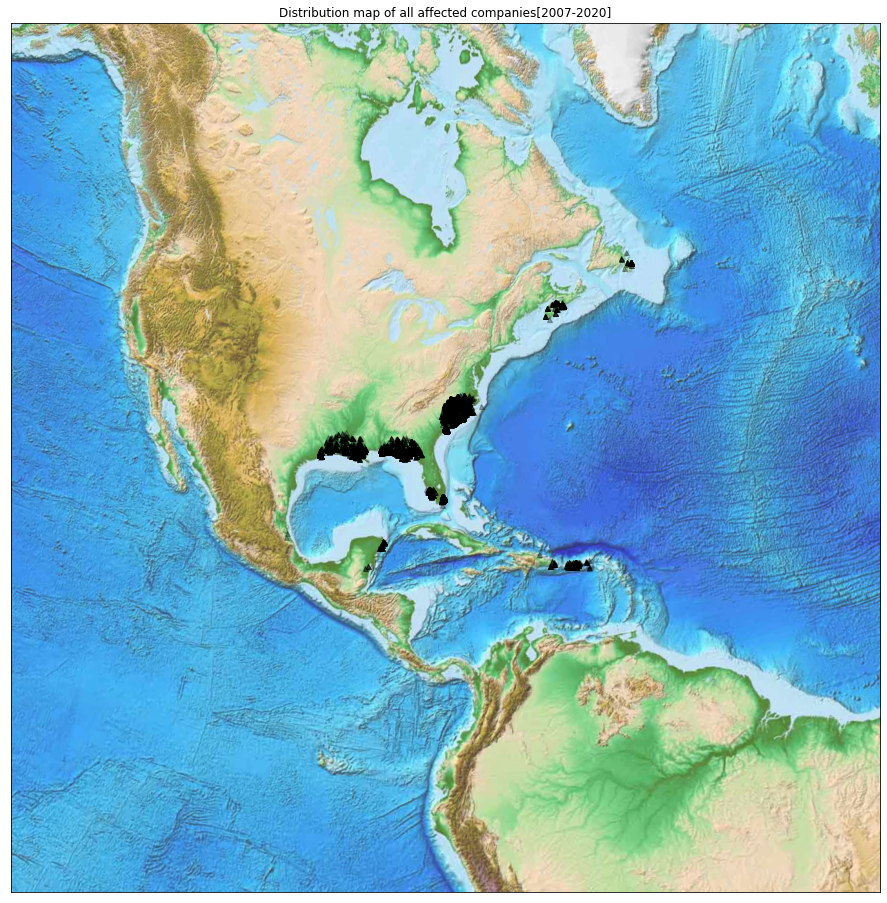

In [8]:
fig = plt.figure(figsize=(16, 16))
m = Basemap(projection='lcc', resolution=None,
            width=10E6, height=10E6, 
            lat_0=30, lon_0=-80,)
m.etopo(scale=1, alpha=0.8)
plt.title("Distribution map of all affected companies[2007-2020]")
for i in range(len(companyname)):
    x, y = m(com_Longitude[i], com_Latitude[i])
    plt.plot(x, y, '^k', markersize=5, alpha=0.3)
    #plt.text(x, y, companyname[i], fontsize=12)

# plot the map combine with hurricanes and companys

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


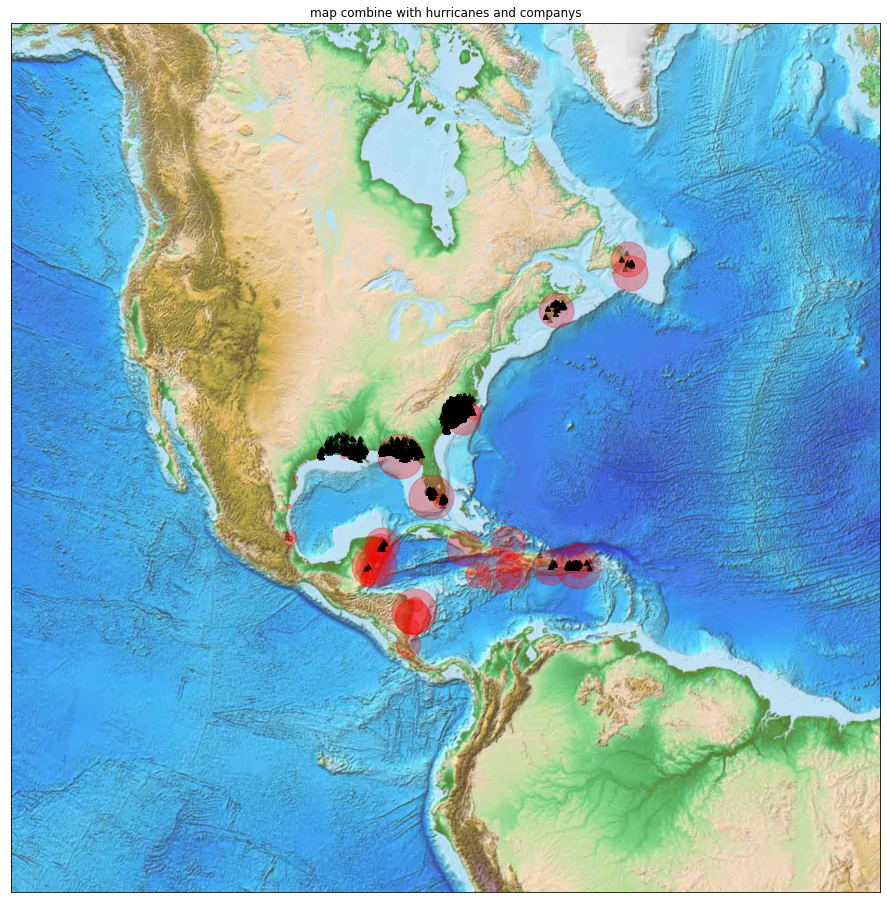

In [9]:
fig = plt.figure(figsize=(16, 16))
m = Basemap(projection='lcc', resolution=None,
            width=10E6, height=10E6, 
            lat_0=30, lon_0=-80,)
m.etopo(scale=1, alpha=0.8)
plt.title("map combine with hurricanes and companys")
for i in range(len(stormname)):
    x, y = m(LF_Lon[i], LF_Lat[i])
    if Category[i] == 1:
        plt.plot(x, y, 'or', markersize=5, alpha=0.3)
        #plt.text(x, y, stormname[i], fontsize=12)
    elif Category[i] == 2:
        plt.plot(x, y, 'or', markersize=15, alpha=0.3)
        #plt.text(x, y, stormname[i], fontsize=12)
    elif Category[i] == 3:
        plt.plot(x, y, 'or', markersize=25, alpha=0.3)
        #plt.text(x, y, stormname[i], fontsize=12)
    elif Category[i] == 4:
        plt.plot(x, y, 'or', markersize=35, alpha=0.3)
        #plt.text(x, y, stormname[i], fontsize=12)
    elif Category[i] == 5:
        plt.plot(x, y, 'or', markersize=45, alpha=0.3)
        #plt.text(x, y, stormname[i], fontsize=12)
for i in range(len(companyname)):
    x, y = m(com_Longitude[i], com_Latitude[i])
    plt.plot(x, y, '^k', markersize=5, alpha=0.3)
    #plt.text(x, y, companyname[i], fontsize=12)

In [10]:
assets = pd.read_csv(os.path.join(repo, "data", "interim", "StormAssets.csv"))
assets

,Unnamed: 0,InstitutionName,PropertyKey,PropertyName,Ticker,CompanyNameShort,Latitude,Longitude,PrimaryPropertyType,AcquisitionDate,SoldDate,StormName,Year,HitDate,Category,HitCategory
0,0,American Financial Realty Trust,74982,Beaumont,NaN,American Financial Realty Tr.,30.084644,-94.126774,Office,2004-10-01 00:00:00,2008-04-01 00:00:00,HUMBERTO2007,2007,2007-09-13 09:00:00,1,0
1,1,American Financial Realty Trust,75136,Nederland,NaN,American Financial Realty Tr.,29.974953,-93.992012,Office,2004-10-01 00:00:00,2008-04-01 00:00:00,HUMBERTO2007,2007,2007-09-13 09:00:00,1,0
2,2,"American Realty Capital Trust III, Inc.",217247,Mattress Firm-Nederland,NaN,American Realty Capital Tr III,29.948446,-93.992877,Other Retail,2012-09-30 00:00:00,2013-02-28 00:00:00,HUMBERTO2007,2007,2007-09-13 09:00:00,1,0
3,3,"American Realty Capital Trust, Inc.",185488,Restaurants-Quick Service-Beaumont,NaN,American Realty Capital Trust,30.096670,-94.111580,Specialty,2010-06-29 00:00:00,2013-01-22 00:00:00,HUMBERTO2007,2007,2007-09-13 09:00:00,1,0
4,4,"American Realty Investors, Inc.",363531,Farnham Park,ARL,American Realty Investors Inc.,29.947540,-93.983540,Multifamily,2018-11-30 00:00:00,2020-07-16 00:00:00,HUMBERTO2007,2007,2007-09-13 09:00:00,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9850,9850,Fibra UNO,370238,Centro Maya-Morado,FUNO 11,Fibra UNO,20.618860,-87.097010,Other Retail,2012-08-31 00:00:00,NaN,ZETA2020,2020,2020-10-27 03:55:00,3,0
9851,9851,FibraHotel,266776,Hotel Cacao Playa del Carmen,FIHO 12,FibraHotel,20.632920,-87.067420,Hotel,2014-11-19 00:00:00,NaN,ZETA2020,2020,2020-10-27 03:55:00,3,0
9852,9852,Hyatt Hotels Corporation,316369,Andaz-Mayakoba Resort Riviera Maya,H,Hyatt Hotels Corp.,20.694900,-87.029250,Hotel,2016-12-31 00:00:00,NaN,ZETA2020,2020,2020-10-27 03:55:00,3,1
9853,9853,Playa Hotels & Resorts N.V.,309176,Hilton-Playa del Carmen,PLYA,Playa Hotels & Resorts N.V.,20.629690,-87.068220,Hotel,NaN,NaN,ZETA2020,2020,2020-10-27 03:55:00,3,0


# plot companies affected by hurricanes each year

In [11]:
asset_info = assets[['PropertyName', 'Latitude', 'Longitude', 'StormName', 'Year', 'Category']]
asset_info

,PropertyName,Latitude,Longitude,StormName,Year,Category
0,Beaumont,30.084644,-94.126774,HUMBERTO2007,2007,1
1,Nederland,29.974953,-93.992012,HUMBERTO2007,2007,1
2,Mattress Firm-Nederland,29.948446,-93.992877,HUMBERTO2007,2007,1
3,Restaurants-Quick Service-Beaumont,30.096670,-94.111580,HUMBERTO2007,2007,1
4,Farnham Park,29.947540,-93.983540,HUMBERTO2007,2007,1
...,...,...,...,...,...,...
9850,Centro Maya-Morado,20.618860,-87.097010,ZETA2020,2020,3
9851,Hotel Cacao Playa del Carmen,20.632920,-87.067420,ZETA2020,2020,3
9852,Andaz-Mayakoba Resort Riviera Maya,20.694900,-87.029250,ZETA2020,2020,3
9853,Hilton-Playa del Carmen,20.629690,-87.068220,ZETA2020,2020,3


In [12]:
asset_info['StormName']

0       HUMBERTO2007
1       HUMBERTO2007
2       HUMBERTO2007
3       HUMBERTO2007
4       HUMBERTO2007
            ...     
9850        ZETA2020
9851        ZETA2020
9852        ZETA2020
9853        ZETA2020
9854        ZETA2020
Name: StormName, Length: 9855, dtype: object

In [13]:
asset_info['Storm'] = asset_info['StormName'].apply(lambda x: x[:-4])
asset_info

,PropertyName,Latitude,Longitude,StormName,Year,Category,Storm
0,Beaumont,30.084644,-94.126774,HUMBERTO2007,2007,1,HUMBERTO
1,Nederland,29.974953,-93.992012,HUMBERTO2007,2007,1,HUMBERTO
2,Mattress Firm-Nederland,29.948446,-93.992877,HUMBERTO2007,2007,1,HUMBERTO
3,Restaurants-Quick Service-Beaumont,30.096670,-94.111580,HUMBERTO2007,2007,1,HUMBERTO
4,Farnham Park,29.947540,-93.983540,HUMBERTO2007,2007,1,HUMBERTO
...,...,...,...,...,...,...,...
9850,Centro Maya-Morado,20.618860,-87.097010,ZETA2020,2020,3,ZETA
9851,Hotel Cacao Playa del Carmen,20.632920,-87.067420,ZETA2020,2020,3,ZETA
9852,Andaz-Mayakoba Resort Riviera Maya,20.694900,-87.029250,ZETA2020,2020,3,ZETA
9853,Hilton-Playa del Carmen,20.629690,-87.068220,ZETA2020,2020,3,ZETA


In [14]:
storm_info = storm[['Name','Category', 'LF_Lat', 'LF_Lon']]
storm_info['year'] = storm_info['Name'].apply(lambda x: int(x[-4:]))
storm_info

,Name,Category,LF_Lat,LF_Lon,year
0,DEAN2007,5.0,18.7000,-87.7000,2007
1,FELIX2007,5.0,14.3000,-83.2000,2007
2,HUMBERTO2007,1.0,29.8569,-94.0434,2007
3,LORENZO2007,1.0,20.5000,-97.0000,2007
4,NOEL2007,1.0,19.7408,-73.2102,2007
5,DOLLY2008,2.0,20.8000,-87.0000,2008
6,GUSTAV2008,4.0,18.1000,-72.8000,2008
7,HANNA2008,1.0,34.5805,-78.4980,2008
8,IKE2008,4.0,21.0000,-73.2000,2008
9,KYLE2008,1.0,43.8000,-66.2000,2008


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

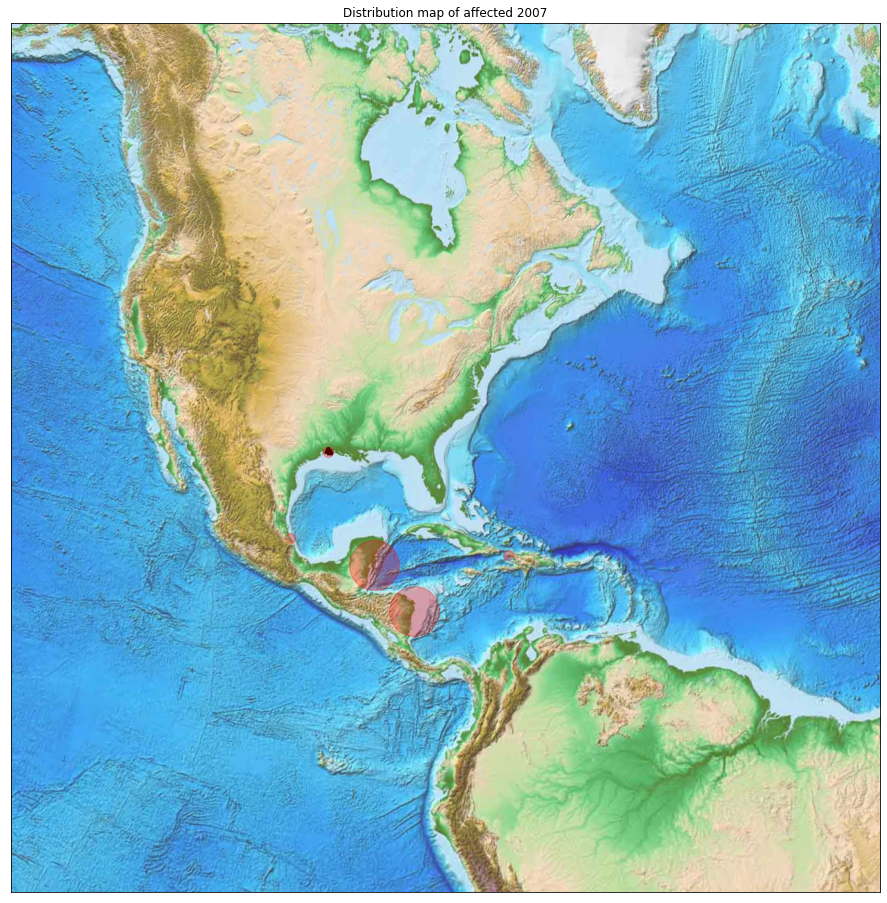

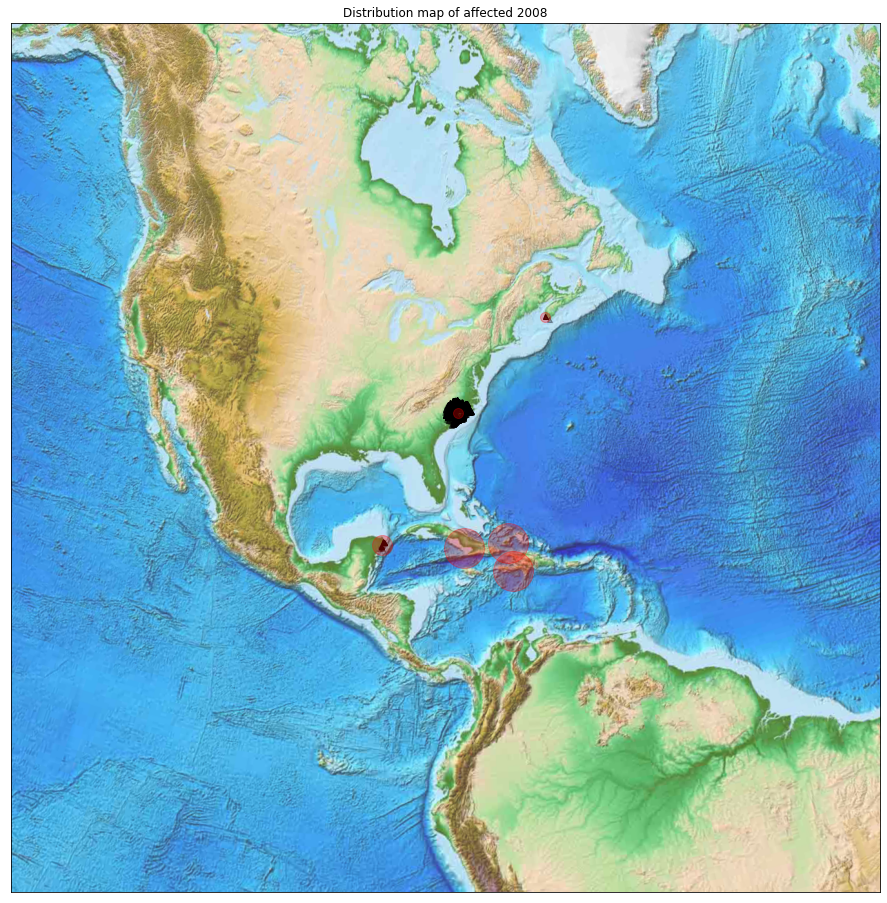

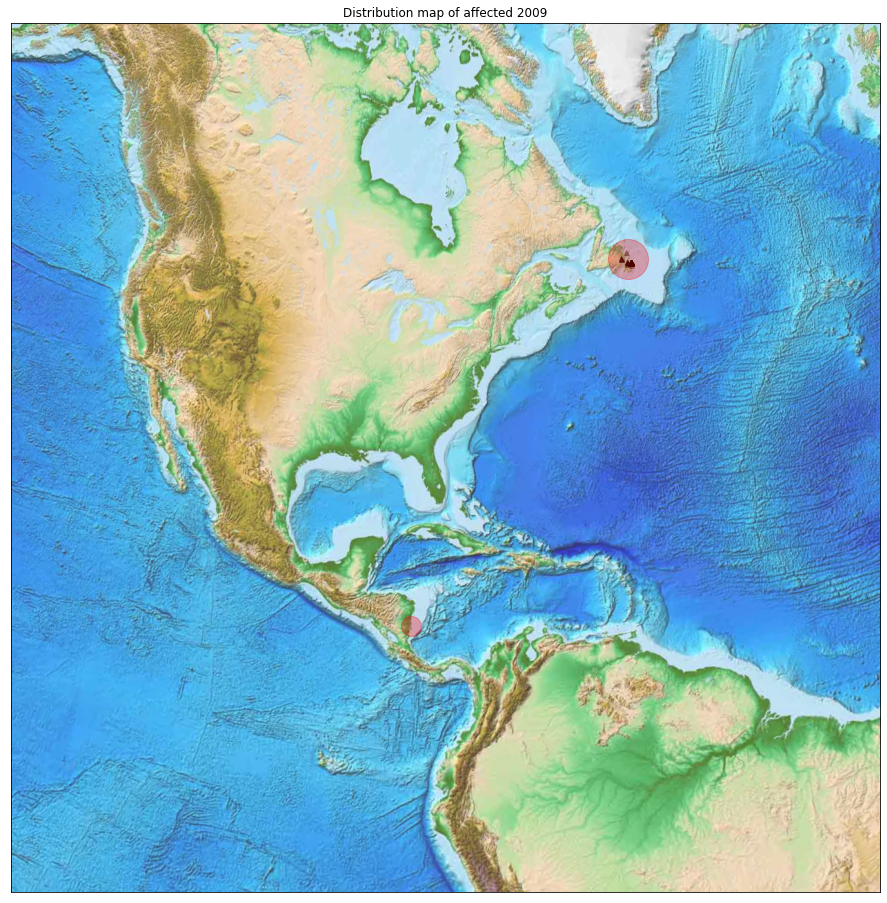

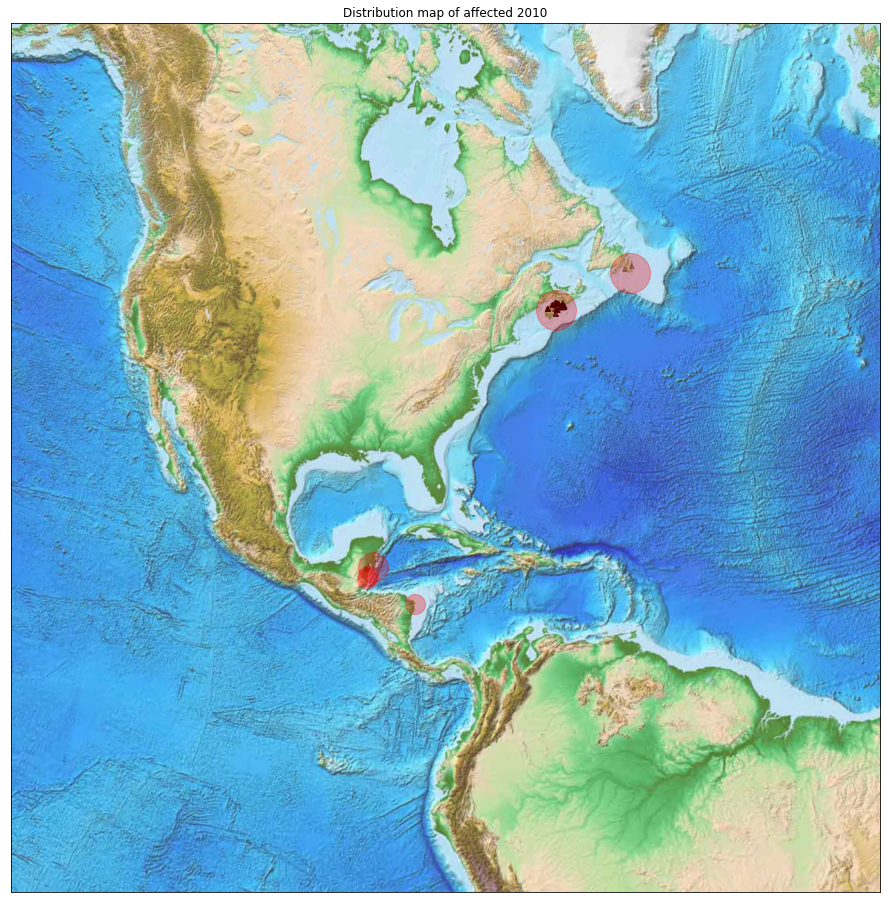

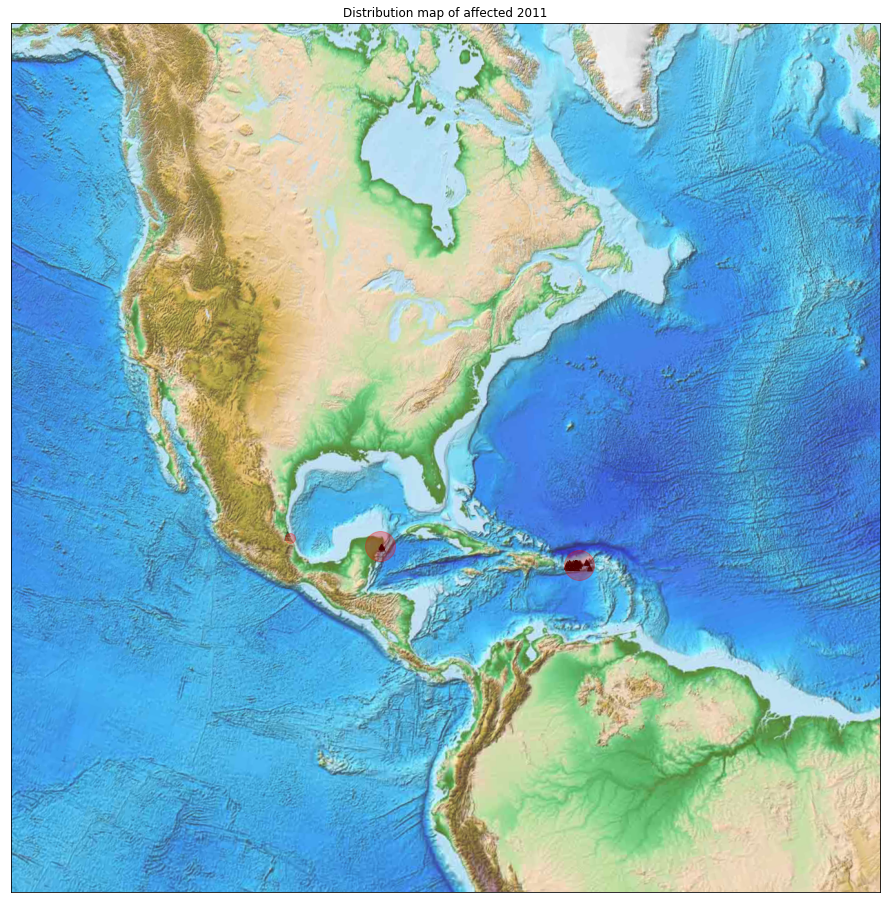

...

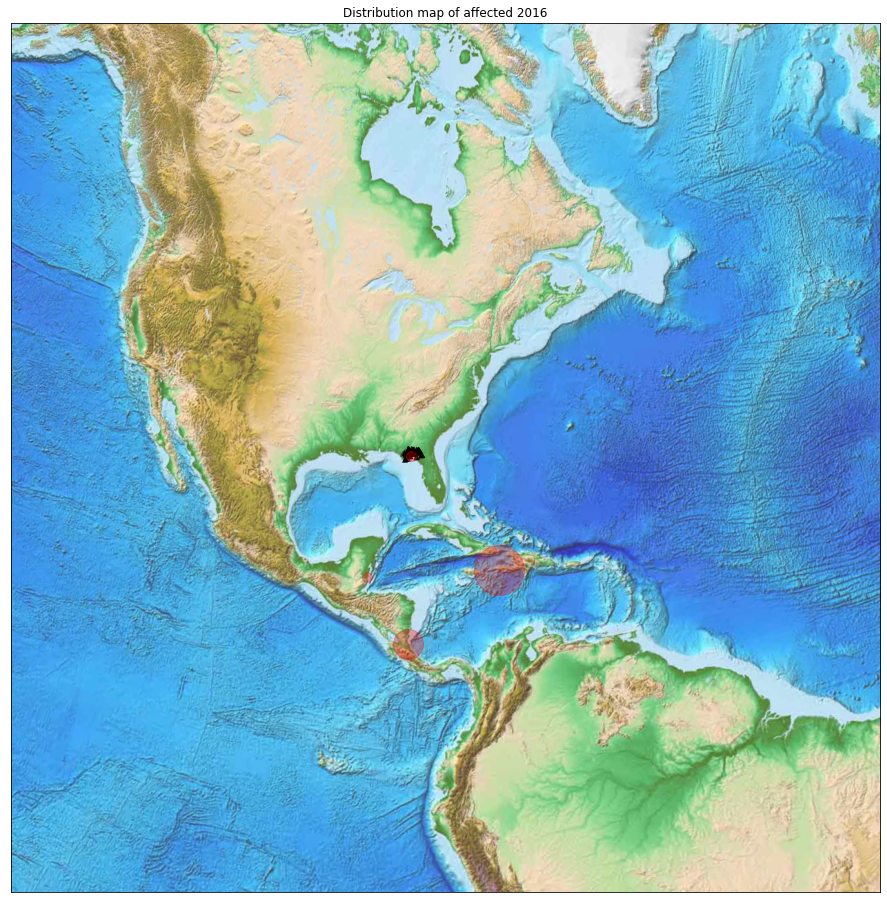

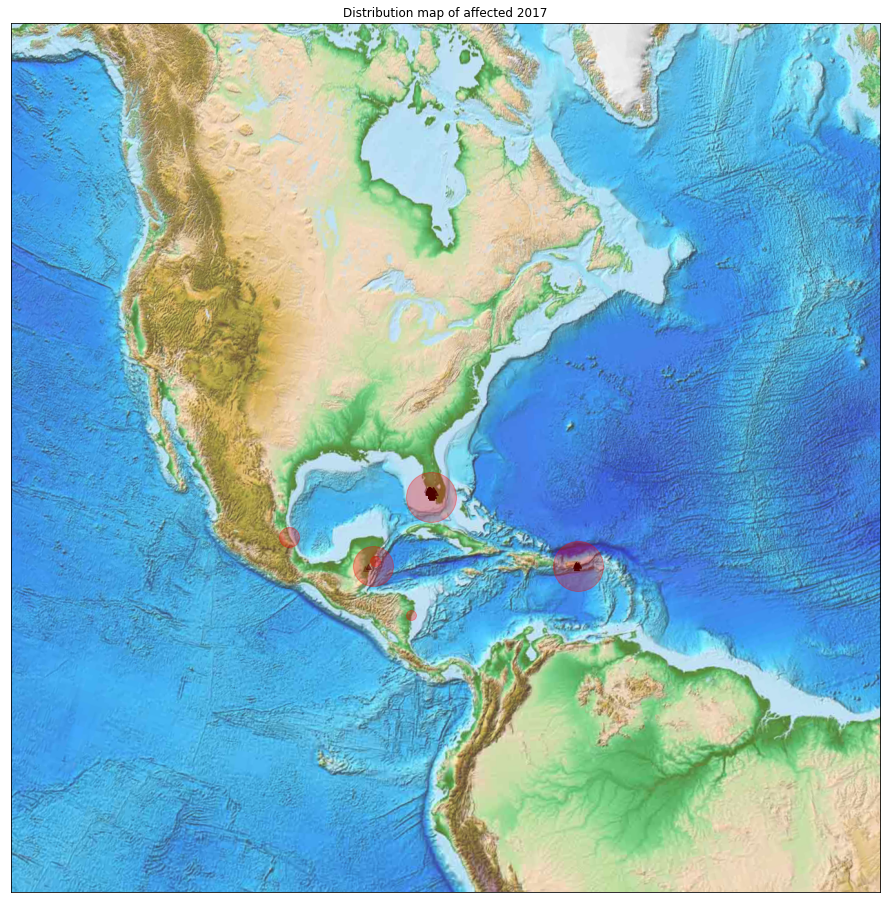

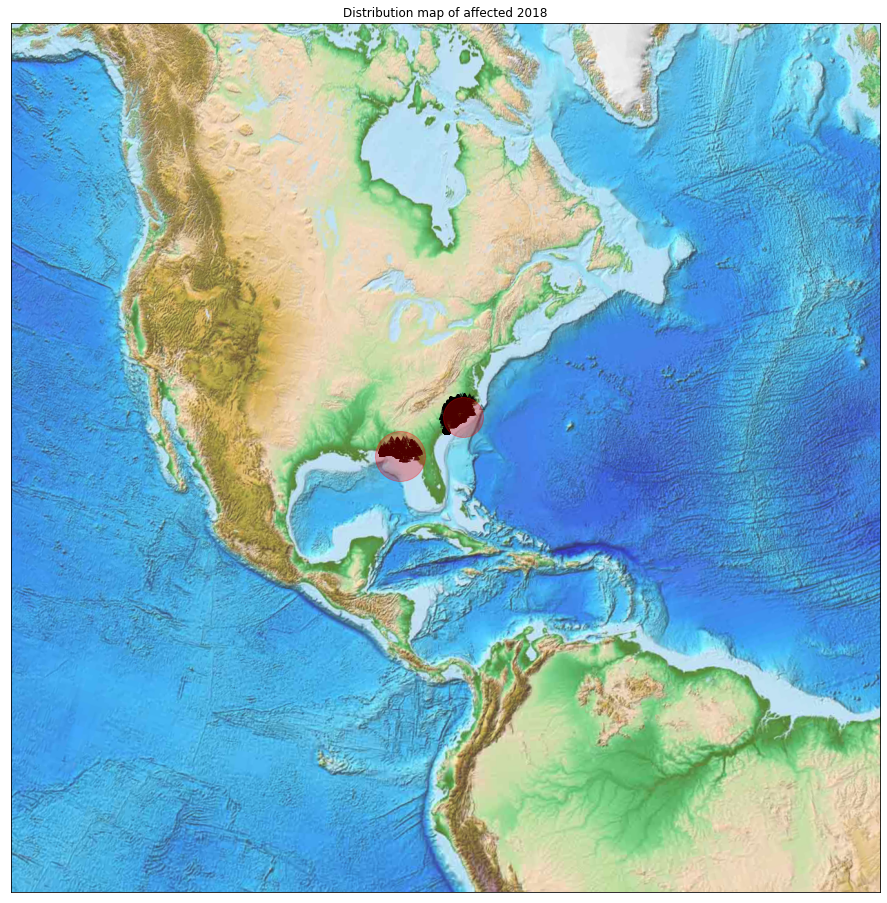

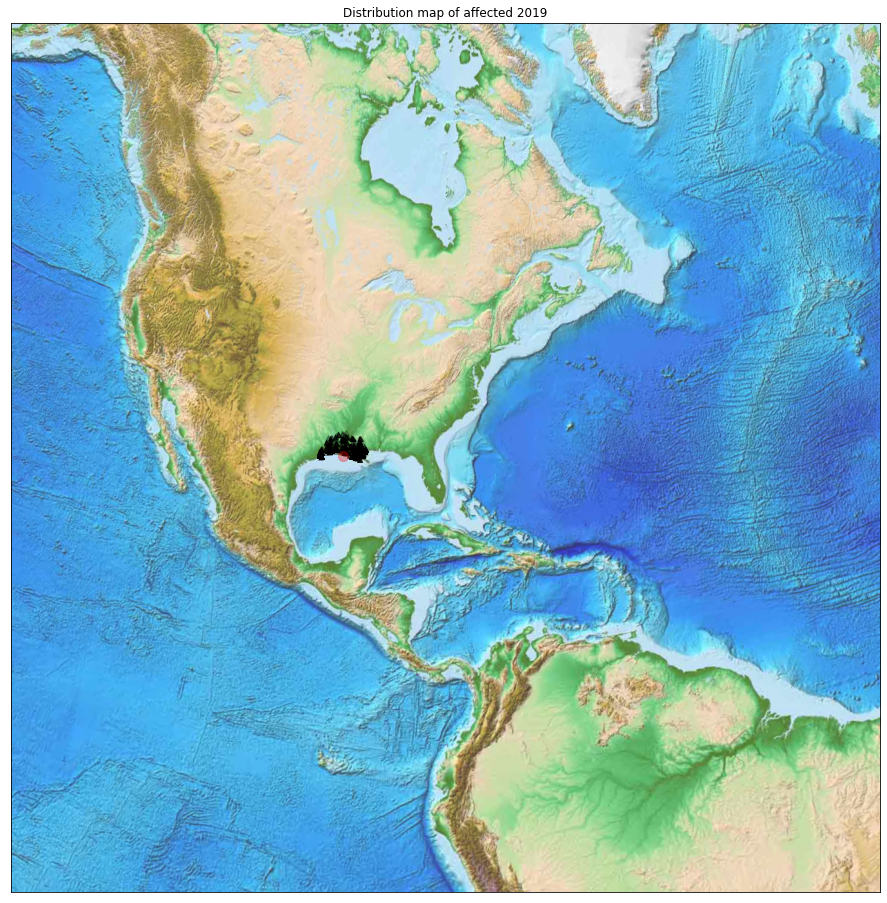

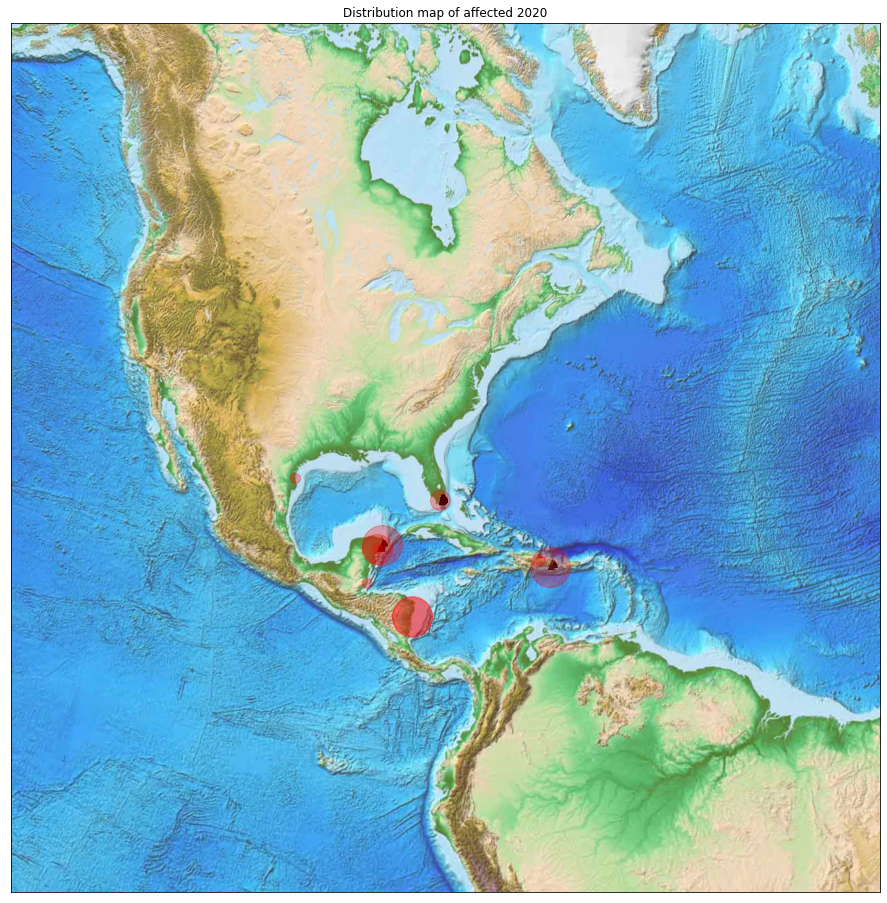

In [15]:
for i in range(int(storm_info.year.min()), int(storm_info.year.max())+1):
    asset_eayear = asset_info[asset_info.Year==i]
    storm_eayear = storm_info[storm_info.year==i]
    asset_eayear = asset_eayear.reset_index(drop=True)
    storm_eayear = storm_eayear.reset_index(drop=True)
    fig = plt.figure(figsize=(16, 16))
    m = Basemap(projection='lcc', resolution=None,
                width=10E6, height=10E6, 
                lat_0=30, lon_0=-80,)
    m.etopo(scale=1, alpha=0.8)
    plt.title(f'Distribution map of affected {i}')
    for j in range(len(asset_eayear)):
        x, y = m(asset_eayear.Longitude[j], asset_eayear.Latitude[j])
        plt.plot(x, y, '^k', markersize=5, alpha=0.3)
        #plt.text(x, y, companyname[i], fontsize=12)
    for k in range(len(storm_eayear)):
        x, y = m(storm_eayear.LF_Lon[k], storm_eayear.LF_Lat[k])
        Category = storm_eayear.Category[k]
        if Category == 1:
            plt.plot(x, y, 'or', markersize=10, alpha=0.3)
            #plt.text(x, y, stormname[i], fontsize=8)
        elif Category == 2:
            plt.plot(x, y, 'or', markersize=20, alpha=0.3)
            #plt.text(x, y, stormname[i], fontsize=8)
        elif Category == 3:
            plt.plot(x, y, 'or', markersize=30, alpha=0.3)
            #plt.text(x, y, stormname[i], fontsize=8)
        elif Category == 4:
            plt.plot(x, y, 'or', markersize=40, alpha=0.3)
            #plt.text(x, y, stormname[i], fontsize=8)
        elif Category == 5:
            plt.plot(x, y, 'or', markersize=50, alpha=0.3)
            #plt.text(x, y, stormname[i], fontsize=8)